<a href="https://colab.research.google.com/github/Kingston802/TakiWaehere/blob/main/TakutaiMoana.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Processing

In [ ]:
#Installations
!apt install gdal-bin python-gdal python3-gdal 
!pip install rasterio
!apt install python3-rtree 
!pip install git+git://github.com/geopandas/geopandas.git
!pip install descartes

Reading package lists... Done
Building dependency tree       
Reading state information... Done
gdal-bin is already the newest version (2.2.3+dfsg-2).
python-gdal is already the newest version (2.2.3+dfsg-2).
python3-gdal is already the newest version (2.2.3+dfsg-2).
0 upgraded, 0 newly installed, 0 to remove and 31 not upgraded.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
python3-rtree is already the newest version (0.8.3+ds-1).
0 upgraded, 0 newly installed, 0 to remove and 31 not upgraded.
  Cloning git://github.com/geopandas/geopandas.git to /tmp/pip-req-build-hb5mnkfa
  Running command git clone -q git://github.com/geopandas/geopandas.git /tmp/pip-req-build-hb5mnkfa
  Created wheel for geopandas: filename=geopandas-0.9.0+13.gf4a9763-py2.py3-none-any.whl size=995262 sha256=d2e26161536e46a428fe5fdeed013498b5f58a2dcfb7f11166713103f86c99f0
  Stored in directory: /tmp/pip-ephem-wheel-cache-20e7mr9o/wheels/91/24/71/376c9c67192694168352

In [ ]:
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import rasterio as rio
from rasterio.plot import show


In [ ]:
fpath = '/content/15MAR12221443-M3DS-013930604060_01_P001.TIF'

src_image = rio.open(fpath)
print(src_image.profile)

{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2669, 'height': 2185, 'count': 8, 'crs': CRS.from_epsg(32759), 'transform': Affine(2.0, 0.0, 719250.0,
       0.0, -2.0, 5301760.0), 'tiled': False, 'interleave': 'band'}


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
overview = src_image.overviews(1)
overview

NameError: ignored

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


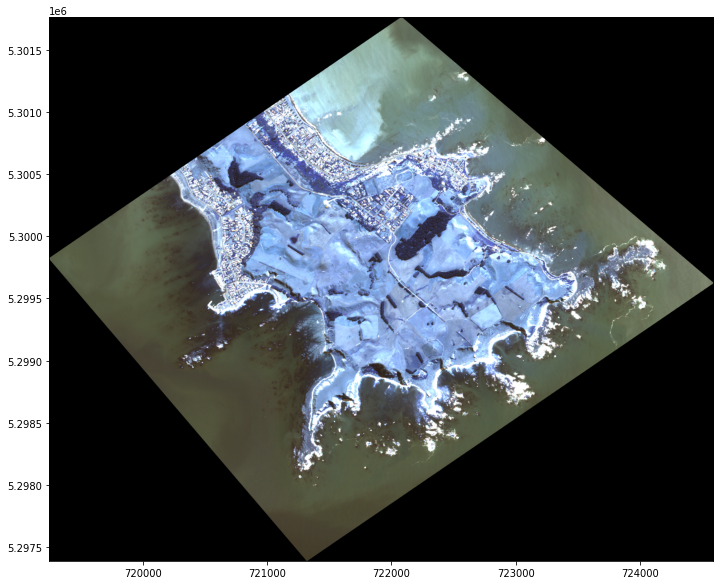

In [ ]:
fig, ax = plt.subplots(1, figsize=(12, 10))
show(src_image, ax=ax)
plt.show()

Multispectral Band Key:
Band 1: Coastal Blue
Band 2: Blue
Band 3: Green
Band 4: Yellow
Band 5: Red
Band 6: Red-Edge
Band 7: NIR1
Band 8: NIR2

In [ ]:
src_image_array = src_image.read(1)
src_image_array = src_image_array.astype("f4")
src_image_array

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [ ]:
src_image_array2 = src_image.read(8)
src_image_array2 = src_image_array2.astype("f4")
src_image_array2

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [ ]:
src_image_array[src_image_array==0] = np.nan

In [ ]:
src_image_array2[src_image_array2==0] = 0

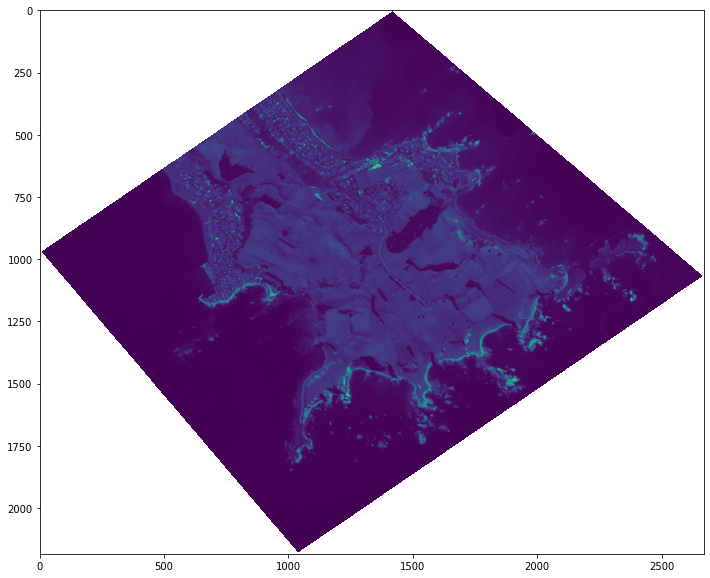

In [ ]:
fig, ax = plt.subplots(1, figsize=(12, 10))
show(src_image_array, ax=ax)
plt.show()

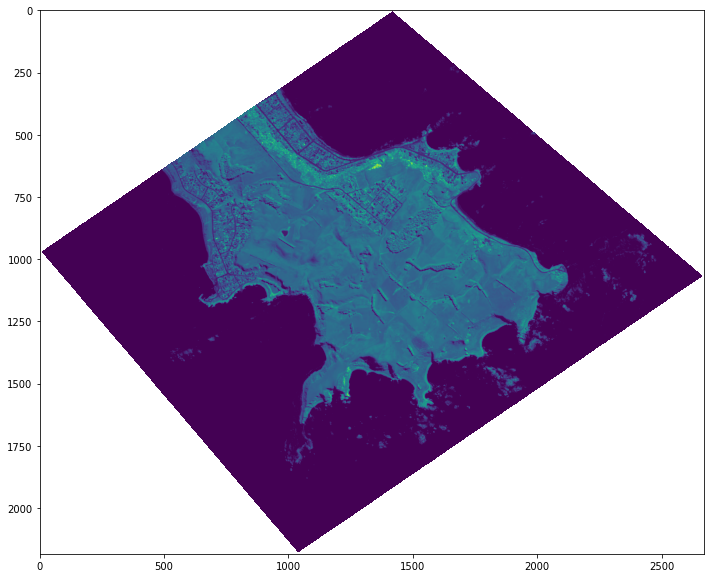

In [ ]:
fig2, ax2 = plt.subplots(1, figsize=(12, 10))
show(src_image_array2, ax=ax2)
plt.show()

In [ ]:
src_image.profile

{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7601, 'height': 7741, 'count': 1, 'crs': CRS.from_epsg(32619), 'transform': Affine(30.0, 0.0, 363285.0,
       0.0, -30.0, -683685.0), 'blockxsize': 512, 'blockysize': 512, 'tiled': True, 'compress': 'deflate', 'interleave': 'band'}

In [ ]:
src_image.indexes

(1, 2, 3, 4, 5, 6, 7, 8)

In [ ]:
src_image.read(6)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

## Get subset of the image

Window(col_off, row_off, width, height)

In [ ]:
window = rio.windows.Window(1200, 1200, 750, 850)

In [ ]:



subset = src_image.read(1, window=window)

In [ ]:
#subset.profile

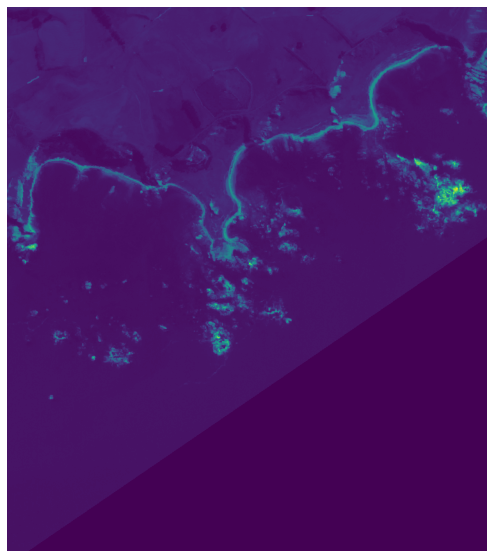

In [ ]:
fig, ax = plt.subplots(1, figsize=(12, 10))
show(subset, ax=ax)
ax.set_axis_off()
plt.show()

## RGB

In [ ]:
rpath = 'http://landsat-pds.s3.amazonaws.com/c1/L8/003/065/LC08_L1TP_003065_20190925_20191017_01_T1/LC08_L1TP_003065_20190925_20191017_01_T1_B4.TIF'
gpath = 'http://landsat-pds.s3.amazonaws.com/c1/L8/003/065/LC08_L1TP_003065_20190925_20191017_01_T1/LC08_L1TP_003065_20190925_20191017_01_T1_B3.TIF'
bpath = 'http://landsat-pds.s3.amazonaws.com/c1/L8/003/065/LC08_L1TP_003065_20190925_20191017_01_T1/LC08_L1TP_003065_20190925_20191017_01_T1_B2.TIF'

In [ ]:
red = rio.open(rpath)
green = rio.open(gpath)
blue = rio.open(bpath)

In [ ]:
red_array = red.read(1)
green_array = green.read(1)
blue_array = blue.read(1)

In [ ]:
red.profile

{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7601, 'height': 7741, 'count': 1, 'crs': CRS.from_epsg(32619), 'transform': Affine(30.0, 0.0, 363285.0,
       0.0, -30.0, -683685.0), 'blockxsize': 512, 'blockysize': 512, 'tiled': True, 'compress': 'deflate', 'interleave': 'band'}

In [ ]:
red.width

7601

In [ ]:
src_image.transform

Affine(30.0, 0.0, 363285.0,
       0.0, -30.0, -683685.0)

In [ ]:
# Create an RGB image 
with rio.open('RGB.tiff','w',driver='Gtiff', width=red.width, height=red.height, 
              count=3,crs=red.crs,transform=red.transform, dtype=red.dtypes[0]) as rgb:
    rgb.write(blue.read(1),1) 
    rgb.write(green.read(1),2) 
    rgb.write(red.read(1),3) 
    rgb.close()

In [ ]:
rgb = rio.open("/content/RGB.tiff")

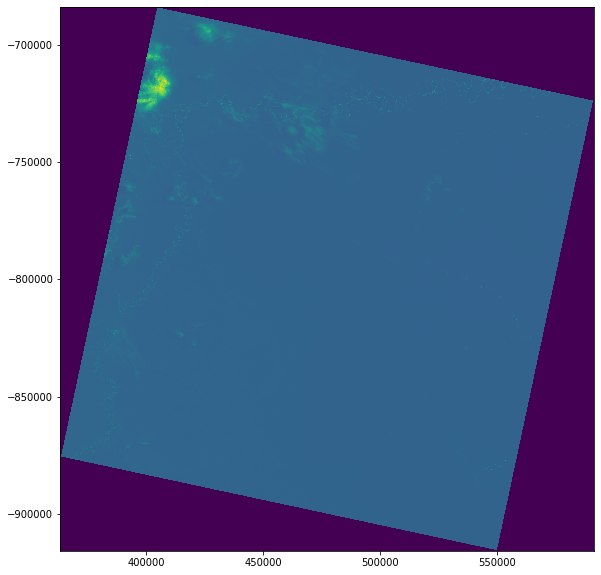

In [ ]:
fig, ax = plt.subplots(1, figsize=(12, 10))
show(rgb, ax=ax, cmap="viridis")
plt.show()

# Bathymetry

In [ ]:
# installs
!pip install pysolar
!pip install pytz

##radiance

In [335]:
class image:
  def __init__(self, img, calcof, bandwidth, lat, lon, date):
    self.img = img 
    self.calcof = calcof
    self.bandwidth = bandwidth
    self.lat = lat
    self.lon = lon
    self.date = date

# getting calcoef and bandwidth for this file 
md = '/content/15MAR12221443-M3DS-013930604060_01_P001.IMD'

start = 0
end = 0
output = []
with open(md) as f:
  for i, line in enumerate(f):
    if 'BEGIN_GROUP = BAND_B' in line:
      start = i
    if 'END_GROUP = BAND_B' in line:
      end = i
    if 'earliestAcqTime' in line:
      timeLine = line
      print(timeLine[19:38])
    output.append(line)
  
calc = float(output[end-3][16:28])
band = float(output[end-2][22:34])

time_zone = 'Pacific/Auckland'
local = pytz.timezone(time_zone)
dateobj = datetime.datetime.strptime(timeLine[19:38], '%Y-%m-%dT%H:%M:%S')
dateobj = dateobj.replace(tzinfo=local)

# find lat and longitude
lat = float(output[end-5][10:22])
lon = float(output[end-6][10:22])
testimg = image(src_image.read(2), calc, band, lat, lon, dateobj)

def radiance(img):
  # calculating llambda
  llambda = [[(y*(10**4))/(img.calcof*img.bandwidth) for y in x] for x in img.img]
  return llambda

llambda = radiance(testimg)
llambda

2015-03-12T22:14:43


[[0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,

## reflection

In [337]:
from pysolar.solar import *
import datetime
import math
import time
import pytz

# find solar zenith angle 
def solarangle(img):
  sza = float(90)-get_altitude(img.lat, img.lon, img.date)
  print('solar zenith angle:', sza)
  return sza 

sza = solarangle(testimg)

solar zenith angle: 126.82181159257638


2185


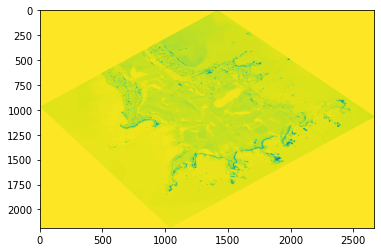

In [338]:
ESUN = 1500 # guess lol 
print(len(llambda))
def reflection():
  rholambda = [[math.pi*ly*1/(ESUN*math.cos(2*math.pi/360 * sza)) for ly in lx] for lx in llambda]
  return rholambda
rholambda = reflection()
plt.imshow(rholambda, aspect='auto')

## depth

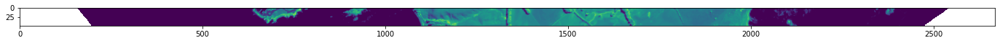

In [339]:
fig2, ax2 = plt.subplots(1, figsize=(24, 20))
section = src_image_array2[1050:1200][100:300]
show(section, ax=ax2)
plt.show()


In [330]:
# getting calcoef and bandwidth for this file 
md = '/content/15MAR12221443-M3DS-013930604060_01_P001.IMD'

start = 0
end = 0
output = []
with open(md) as f:
  for i, line in enumerate(f):
    if 'BEGIN_GROUP = BAND_B' in line:
      start = i
    if 'END_GROUP = BAND_B' in line:
      end = i
    if 'earliestAcqTime' in line:
      timeLine = line
      print(timeLine[19:38])
    output.append(line)
  
calc = float(output[end-3][16:28])
band = float(output[end-2][22:34])

time_zone = 'Pacific/Auckland'
local = pytz.timezone(time_zone)
dateobj = datetime.datetime.strptime(timeLine[19:38], '%Y-%m-%dT%H:%M:%S')
dateobj = dateobj.replace(tzinfo=local)

# find lat and longitude
lat = float(output[end-5][10:22])
lon = float(output[end-6][10:22])
testimg = image(section, calc, band, lat, lon, dateobj)

llambda = radiance(testimg)
sza = solarangle(testimg)
rholambda = reflection()
len(rholambda)
c = np.average(np.nan_to_num(rholambda))
print("average:", np.average(np.nan_to_num(rholambda)))
print("nan percentage:", np.count_nonzero(np.isnan(rholambda))/(len(rholambda)*len(rholambda[0]))*100)

2015-03-12T22:14:43
solar zenith angle: 126.82181159257638
average: -17548999.260401595
nan percentage: 12.355938553765455


In [ ]:
# finding b value 

$$ b=\frac{\zeta - c_i}{\log R(\lambda_i)} $$

$$ \zeta = 3m $$

In [ ]:
R = rholambda[0][650] # R(\lambda_i)

In [ ]:
b = (2*10**9-c)/(math.log(R,10))
b

294872129.3758745

1.9886991114013335

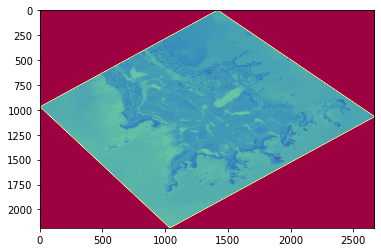

In [349]:
depth = [[b*math.log10(math.fabs(y)) for y in x] for x in np.nan_to_num(rholambda)+1]
np.nan_to_num(rholambda)
plt.imshow(depth, aspect='auto', cmap='Spectral')
depth[1000][2000]/(10**9)

#Machine Learning

In [ ]:
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import sklearn.datasets

from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold, StratifiedKFold, cross_val_score
from autorank import autorank, plot_stats, create_report, latex_table
from statistics import stdev

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, VotingClassifier, GradientBoostingClassifier


# Render matplotlib plots in the notebook
%matplotlib inline

NameError: ignored